In [1]:
import numpy as np
import cv2
from matplotlib.pyplot import plot as plt
from pathlib import Path
from itertools import combinations
import plotly.graph_objects as go
import utils
from utils import to_homo

In [2]:
DATA_ROOT_PATH = Path('data')
IMG_PATH =  DATA_ROOT_PATH / 'q3b.png'
ANNOTATIONS_PATH = DATA_ROOT_PATH / 'q3' / 'q3b.npy'

COLORS = [(0, 255, 0), (0, 255, 255), (255, 255, 0), (255, 0, 0), (0, 0, 255)]

In [3]:
image = utils.load_image(IMG_PATH)

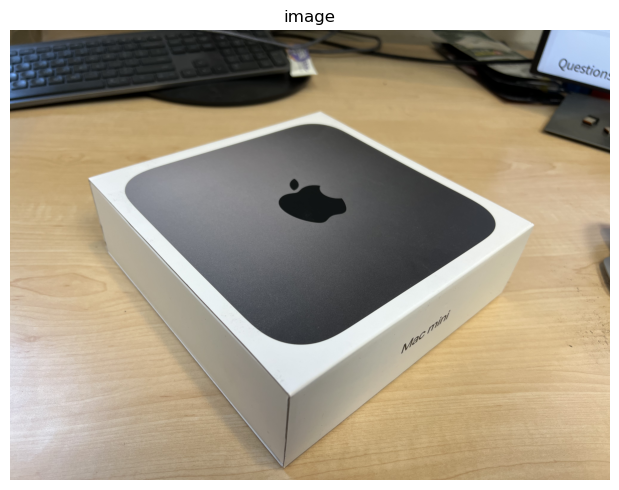

In [4]:
utils.show_images([image], ['image'])

In [5]:
annotations = np.load(ANNOTATIONS_PATH).reshape(3, 4, 2).astype(np.int32)

In [6]:
annotations.shape

(3, 4, 2)

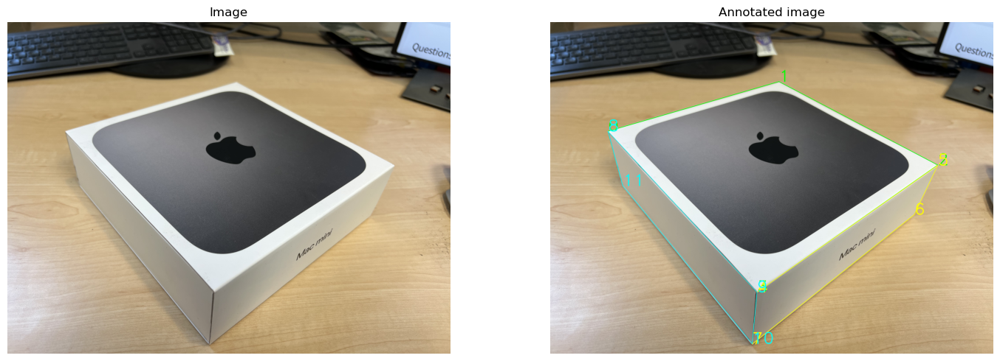

In [7]:
annotated_img = image.copy()

for i in range(annotations.shape[0]):
    COLOR = COLORS[i]
    square = annotations[i]
    for j in range(square.shape[0]):
        x, y = square[j]
        cv2.circle(annotated_img, (x, y), 3, COLOR, -1)
        cv2.putText(
            annotated_img,
            str(j + i * 4),
            (x, y),
            cv2.FONT_HERSHEY_DUPLEX,
            5,
            COLOR,
            3,
            cv2.LINE_AA,
        )
        cv2.line(annotated_img, square[j], square[(j + 1) % 4], COLOR, 3)
    
utils.show_images([image, annotated_img], ['Image', 'Annotated image'])

In [8]:
print(annotations)
annotations.shape

[[[ 525  995]
  [2081  542]
  [3525 1303]
  [1881 2463]]

 [[1881 2463]
  [3525 1306]
  [3312 1756]
  [1837 2936]]

 [[ 525  995]
  [1881 2463]
  [1837 2933]
  [ 660 1492]]]


(3, 4, 2)

In [9]:
planes = np.array([annotations[0, :, :], annotations[1, :, :]])
planes.shape

(2, 4, 2)

In [10]:
lines = []        

line = np.cross(to_homo(planes[0][0]), to_homo(planes[0][1]))
line = line / line[-1]
lines.append(line)
        
line = np.cross(to_homo(planes[0][2]), to_homo(planes[0][3]))
line = line / line[-1]
lines.append(line)

line = np.cross(to_homo(planes[0][0]), to_homo(planes[0][3]))
line = line / line[-1]
lines.append(line)

line = np.cross(to_homo(planes[0][1]), to_homo(planes[0][2]))
line = line / line[-1]
lines.append(line)

line = np.cross(to_homo(planes[1][0]), to_homo(planes[1][3]))
line = line / line[-1]
lines.append(line)

line = np.cross(to_homo(planes[1][1]), to_homo(planes[1][2]))
line = line / line[-1]
lines.append(line)

v_points = []

for i in range(0, len(lines), 2):
    v_point = np.cross(lines[i], lines[i + 1])
    v_point = v_point / v_point[-1]

    v_points.append(v_point)

v_pairs = list(combinations(v_points, 2))
print(v_points)
print(v_pairs)

[array([ 6.37540549e+03, -7.08235017e+02,  1.00000000e+00]), array([-1.76631288e+03, -1.48556586e+03,  1.00000000e+00]), array([1.61283367e+03, 5.34578801e+03, 1.00000000e+00])]
[(array([ 6.37540549e+03, -7.08235017e+02,  1.00000000e+00]), array([-1.76631288e+03, -1.48556586e+03,  1.00000000e+00])), (array([ 6.37540549e+03, -7.08235017e+02,  1.00000000e+00]), array([1.61283367e+03, 5.34578801e+03, 1.00000000e+00])), (array([-1.76631288e+03, -1.48556586e+03,  1.00000000e+00]), array([1.61283367e+03, 5.34578801e+03, 1.00000000e+00]))]


In [11]:
# Constract the A matrix Aw = 0
A = []

for vp in v_pairs:
    xi = vp[0][0]
    yi = vp[0][1]
    xj = vp[1][0]
    yj = vp[1][1]

    equ = [xi * xj + yi * yj, xi + xj, yi + yj, 1]
    A.append(equ)

_, _, vt = np.linalg.svd(A)
W =  vt[-1]
W = W / W[-1]

W = [
        [W[0], 0, W[1]],
        [0, W[0], W[2]],
        [W[1], W[2], W[3]]
    ]

W

[[6.196444812329799e-08, 0, -0.0001229016278395051],
 [0, 6.196444812329799e-08, -9.07327412673623e-05],
 [-0.0001229016278395051, -9.07327412673623e-05, 1.0]]

In [12]:
L = np.linalg.cholesky(W)
K = np.linalg.inv(L).T
K = K / K[2, 2]
K

array([[ 3.17178741e+03,  0.00000000e+00,  1.98342165e+03],
       [-0.00000000e+00,  3.17178741e+03,  1.46427095e+03],
       [-0.00000000e+00,  0.00000000e+00,  1.00000000e+00]])

In [13]:
def get_n_vector(plane, K):
    
    lines = []        
    
    line = np.cross(to_homo(plane[0]), to_homo(plane[1]))
    line = line / line[-1]
    lines.append(line)
            
    line = np.cross(to_homo(plane[2]), to_homo(plane[3]))
    line = line / line[-1]
    lines.append(line)
    
    line = np.cross(to_homo(plane[0]), to_homo(plane[3]))
    line = line / line[-1]
    lines.append(line)
    
    line = np.cross(to_homo(plane[1]), to_homo(plane[2]))
    line = line / line[-1]
    lines.append(line)
    
    v_points = []
    
    for i in range(0, len(lines), 2):
        v_point = np.cross(lines[i], lines[i + 1])
        v_point = v_point / v_point[-1]
    
        v_points.append(v_point)

    d1 = np.linalg.inv(K) @ v_points[0]
    d2 = np.linalg.inv(K) @ v_points[1]

    n = np.cross(d1, d2)
    
    return n

In [14]:
planes_equ = []

scale = 10

X_ref = scale * np.linalg.inv(K) @ to_homo(annotations[0][3])
n = get_n_vector(annotations[0], K)
a = -n.T @ X_ref

planes_equ.append((n, a))

n = get_n_vector(annotations[1], K)
a = -n.T @ X_ref
planes_equ.append((n, a))

n = get_n_vector(annotations[2], K)
a = -n.T @ X_ref
planes_equ.append((n, a))

In [15]:
print(planes_equ)

[(array([ 0.24507659, -2.56691805, -2.09756088]), 29.137431950334438), (array([-1.91836634, -1.51893663,  1.63467921]), -12.183449109899797), (array([-2.08813584,  1.088217  , -1.47079879]), 10.607132166973347)]


In [18]:
def get_plane_mask(corners, H, W):
    mask = np.zeros((H, W), dtype=np.uint8)
    
    pts = corners.astype(np.int32).reshape((-1, 1, 2))
    
    cv2.fillPoly(mask, [pts], 1)
    
    return mask.astype(bool)
    
def reconstruct_scene(planes, masks, K, image):
    H, W = image.shape[:2]
    K_inv = np.linalg.inv(K)

    v, u = np.indices((H, W)) 
    
    pixel_coords = np.stack([u, v, np.ones_like(u)], axis=0).reshape(3, -1)

    all_3d_points = []
    all_colors = []

    for i, (n, a) in enumerate(planes):
        mask = masks[i].flatten()
        
        if np.sum(mask) == 0:
            continue

        coords_in_mask = pixel_coords[:, mask] 
        
        rays = K_inv @ coords_in_mask

        dot_product = n @ rays
        
        dot_product[np.abs(dot_product) < 1e-6] = 1e-6
        
        depths = -a / dot_product
        
        points_3d = rays * depths
        
        all_3d_points.append(points_3d.T)
        
        img_flat = image.reshape(-1, 3)
        colors = img_flat[mask]
        all_colors.append(colors)

    if not all_3d_points:
        return None, None
        
    final_points = np.concatenate(all_3d_points, axis=0)
    final_colors = np.concatenate(all_colors, axis=0)
    
    return final_points, final_colors

def plot_3d(points, colors):
    step = 10
    points_sampled = points[::step]
    colors_sampled = colors[::step]
    
    # Normalize colors to 0-1 range
    c_norm = colors_sampled / 255.0
    
    # Create RGB strings for plotly
    rgb_colors = [f'rgb({int(c[0]*255)},{int(c[1]*255)},{int(c[2]*255)})' 
                  for c in c_norm]
    
    fig = go.Figure(data=[go.Scatter3d(
        x=points_sampled[:, 0],
        y=points_sampled[:, 2],
        z=-points_sampled[:, 1],
        mode='markers',
        marker=dict(
            size=2,
            color=rgb_colors,
        ),
        hoverinfo='skip'  # Disable hover for performance
    )])
    
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Z (Depth)',
            zaxis_title='-Y (Height)',
            aspectmode='data'
        ),
        width=900,
        height=700,
        margin=dict(l=0, r=0, b=0, t=0)
    )
    
    fig.show()

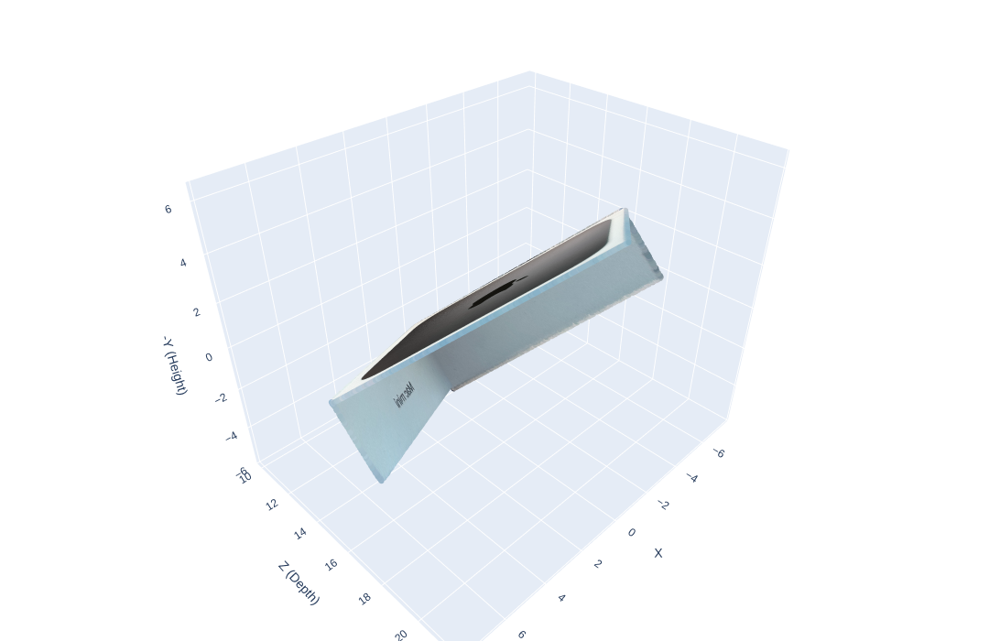

In [19]:
masks_list = []
H, W = image.shape[:2]

for corners in annotations:
    mask = get_plane_mask(corners, H, W)
    masks_list.append(mask)

pts, cols = reconstruct_scene(planes_equ, masks_list, K, image)
plot_3d(pts, cols)